### YOLOv8

#### Instalação e configuração

In [1]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 976.9/976.9 kB 40.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 52.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 40.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 41.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 31.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 17.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 92.6 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

In [2]:
import ultralytics

ultralytics.checks()

Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
Setup complete ✅ (12 CPUs, 53.0 GB RAM, 41.2/235.7 GB disk)


In [3]:
import torch

torch.cuda.is_available() # Caso True, significa que a GPU está ativa

True

Caso estiver utilizando em máquina própria e não houver feito ainda a configuração para GPU, é possível realizar o seguinte comando para configurar:

In [ ]:
#conda install pytorch torchvision torchaudio pytorch-cuda=11.7 -c pytorch -c nvidia

In [4]:
!nvidia-smi

Sun Mar 30 14:25:09 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA L4                      Off |   00000000:00:03.0 Off |                    0 |
| N/A   45C    P8             17W /   72W |       3MiB /  23034MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

#### Clonar repositório (alternativa)

In [ ]:
#!git clone https://github.com/ultralytics/ultralytics
#!pip install -r /content/ultralytics/requirements.txt
#!pip install -qe ultralytics

#### Importação das demais bibliotecas

In [5]:
import cv2
import matplotlib.pyplot as plt
import os
from PIL import Image
from google.colab.patches import cv2_imshow

In [31]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [32]:
IMAGES_DIR = '/content/drive/MyDrive/imagens'

os.path.exists(IMAGES_DIR) # O path das imagens existe

True

###  Download do modelo
- Os modelos do YOLOv8 (ou mais atualizados) podem ser baixados aqui: https://github.com/ultralytics/assets/releases

Não é necessário fazer o download, pois quando executamos a função para fazer as detecções o download é realizado automaticamente.

### Realizando a detecção via **CLI**

**Task** -> Tarefa, podendo ser detecção, segmentação ou classificação.

**Model** -> O modelo que queremos usar. São disponibilizados 5 modelos:
- YOLOv8n (nano)
- YOLOv8s (small)
- YOLOv8m (medium)
- YOLOv8l (large)
- YOLOv8x (extra large)

Nano é o mais rápido e menor, enquanto o Extra Large é o mais preciso, porém mais pesado para rodar, portanto será mais lento. Para o valor desse parâmetro, basta informar o nome e ao lado .pt, pois é a extensão do modelo treinado em PyTorch.

**Mode** -> Basicamente é o que queremos com o comando. Queremos fazer a detecção/inferência/predição, portando deixe =predict. Valores aceitos: [train, val, predict, export]

**Conf** -> É o limiar (threshold) que usaremos para filtrar detecções "fracas".

**Source** -> A imagem ou vídeo que queremos fazer a detecção.

In [12]:
!yolo task=detect mode=predict model=yolov8n.pt conf=0.25 source='/content/drive/MyDrive/imagens/cachorros.jpg' save=True

Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8n summary (fused): 72 layers, 3,151,904 parameters, 0 gradients, 8.7 GFLOPs

image 1/1 /content/drive/MyDrive/imagens/cachorros.jpg: 448x640 3 dogs, 62.1ms
Speed: 5.0ms preprocess, 62.1ms inference, 183.9ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict2
💡 Learn more at https://docs.ultralytics.com/modes/predict


Esse CLI, configurando o Save=True, irá salvar as predições dentro de uma pasta:

/runs/detect/predict (Aqui poderá ter várias pastas, predict, predict2, predict3, etc).

In [36]:
def view(img):
  fig = plt.gcf()
  fig.set_size_inches(16,10)
  plt.axis('off')

  plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  plt.show()

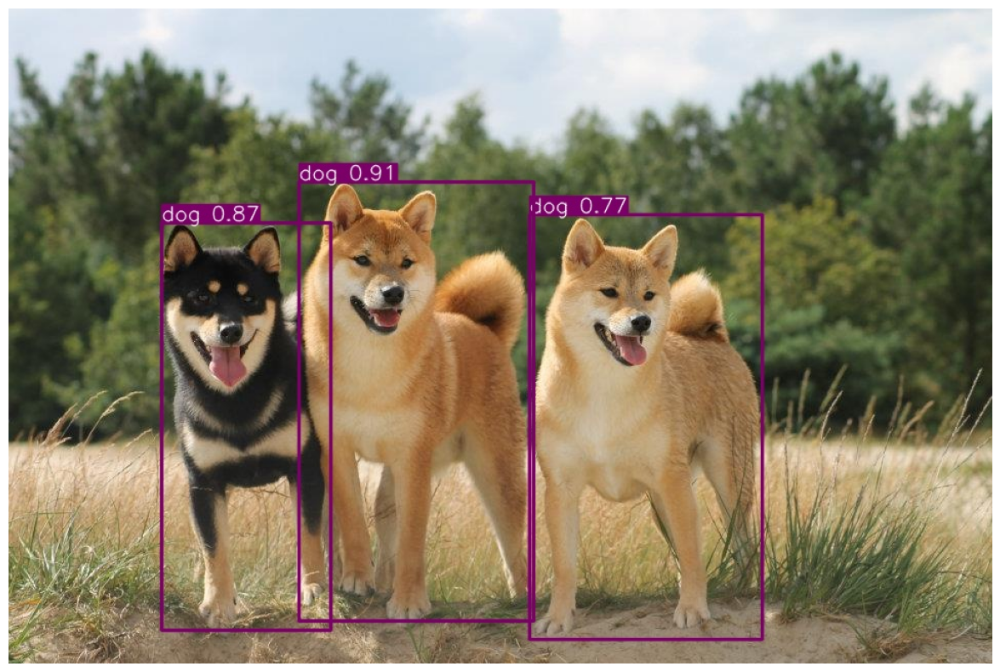

In [37]:
img = cv2.imread('/content/runs/detect/predict2/cachorros.jpg')
view(img)

In [16]:
!yolo task=detect mode=predict model=yolov8n.pt conf=0.25 source='https://ultralytics.com/images/zidane.jpg' save=True

Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8n summary (fused): 72 layers, 3,151,904 parameters, 0 gradients, 8.7 GFLOPs

100% 49.2k/49.2k [00:00<00:00, 85.7MB/s]
image 1/1 /content/zidane.jpg: 384x640 2 persons, 1 tie, 63.1ms
Speed: 4.6ms preprocess, 63.1ms inference, 159.6ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict3
💡 Learn more at https://docs.ultralytics.com/modes/predict


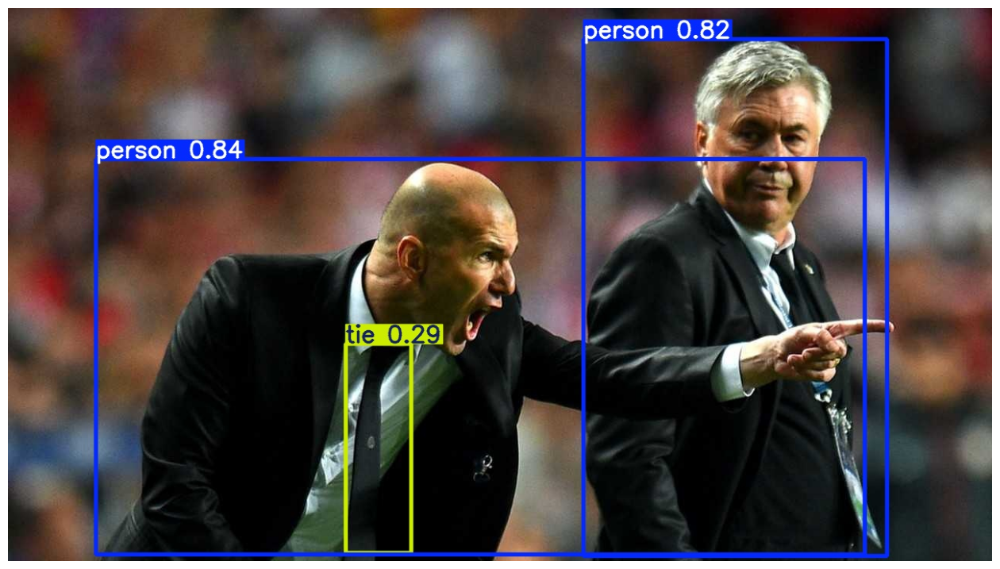

In [17]:
img = cv2.imread('/content/runs/detect/predict3/zidane.jpg')
view(img)

#### Detecção em várias imagens de uma vez

Na CLI, basta colocar o caminho da pasta com as imagens e em seguida, rodar.

In [26]:
!yolo task=detect mode=predict model=yolov8n.pt conf=0.5 source='/content/drive/MyDrive/imagens' save=True

Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8n summary (fused): 72 layers, 3,151,904 parameters, 0 gradients, 8.7 GFLOPs

image 1/8 /content/drive/MyDrive/imagens/apple.jpg: 448x640 1 apple, 62.4ms
image 2/8 /content/drive/MyDrive/imagens/cachorro_gato.jpg: 608x640 2 dogs, 62.7ms
image 3/8 /content/drive/MyDrive/imagens/cachorros.jpg: 448x640 3 dogs, 7.9ms
image 4/8 /content/drive/MyDrive/imagens/cachorros02.jpg: 448x640 2 dogs, 7.2ms
image 5/8 /content/drive/MyDrive/imagens/caneca01.jpg: 384x640 1 cup, 62.5ms
image 6/8 /content/drive/MyDrive/imagens/img-canecas.jpg: 480x640 6 cups, 1 dining table, 62.4ms
image 7/8 /content/drive/MyDrive/imagens/resultado.jpg: 448x640 2 dogs, 8.2ms
image 8/8 /content/drive/MyDrive/imagens/resultado_cachorro.jpg: 448x640 1 cat, 3 dogs, 7.5ms
Speed: 2.8ms preprocess, 35.1ms inference, 26.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict6
💡 Learn more at https://docs.ultral

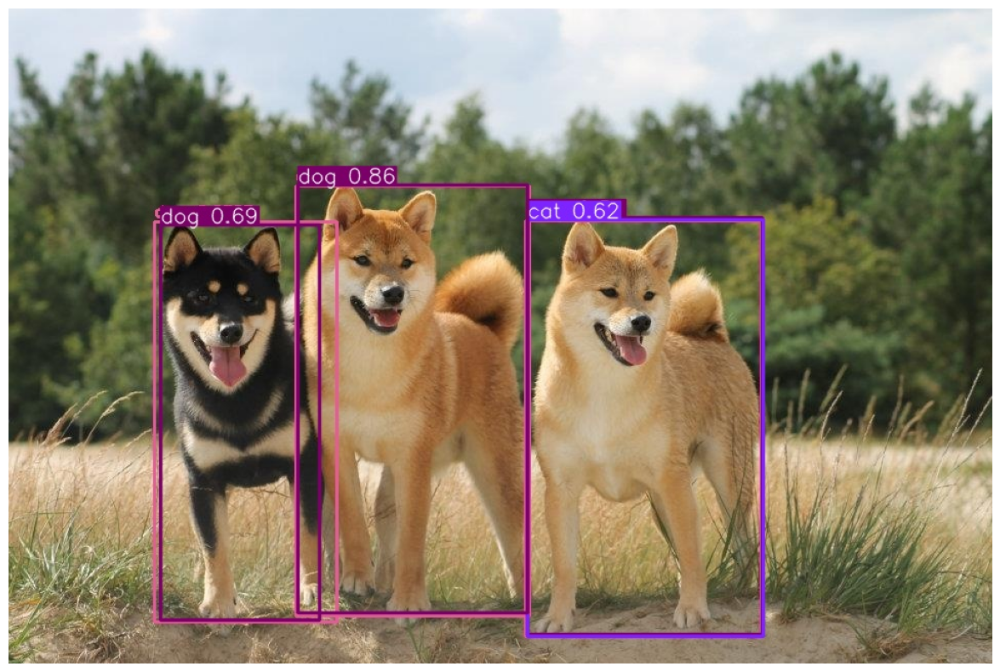

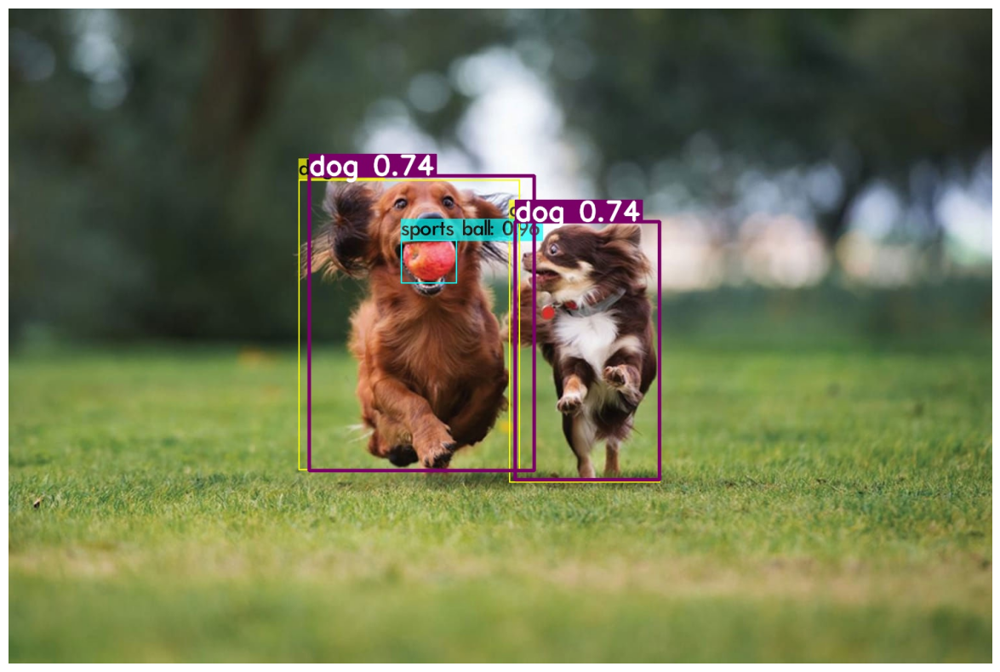

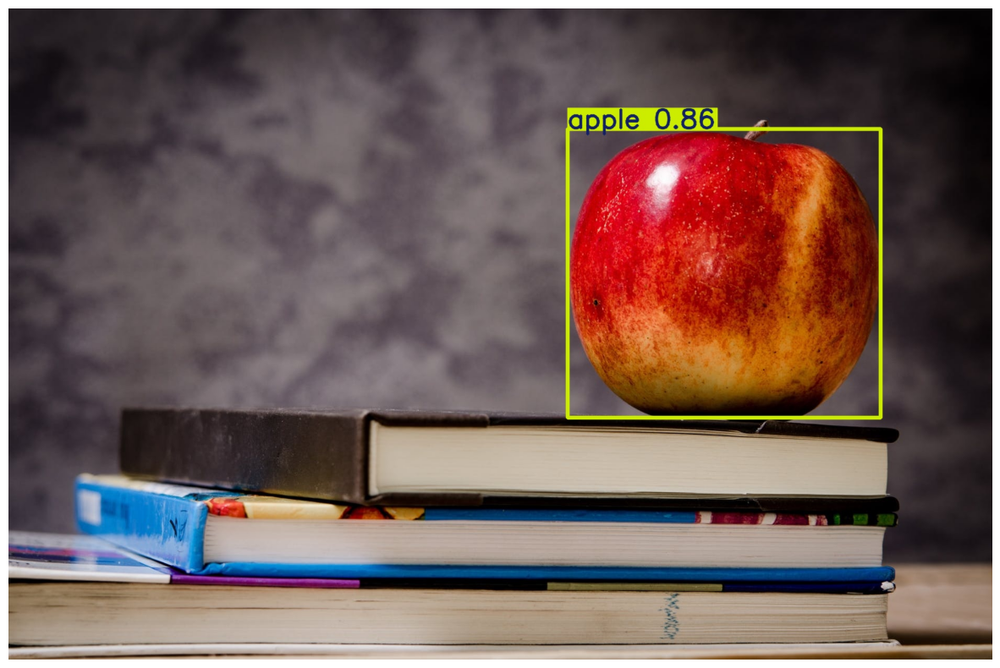

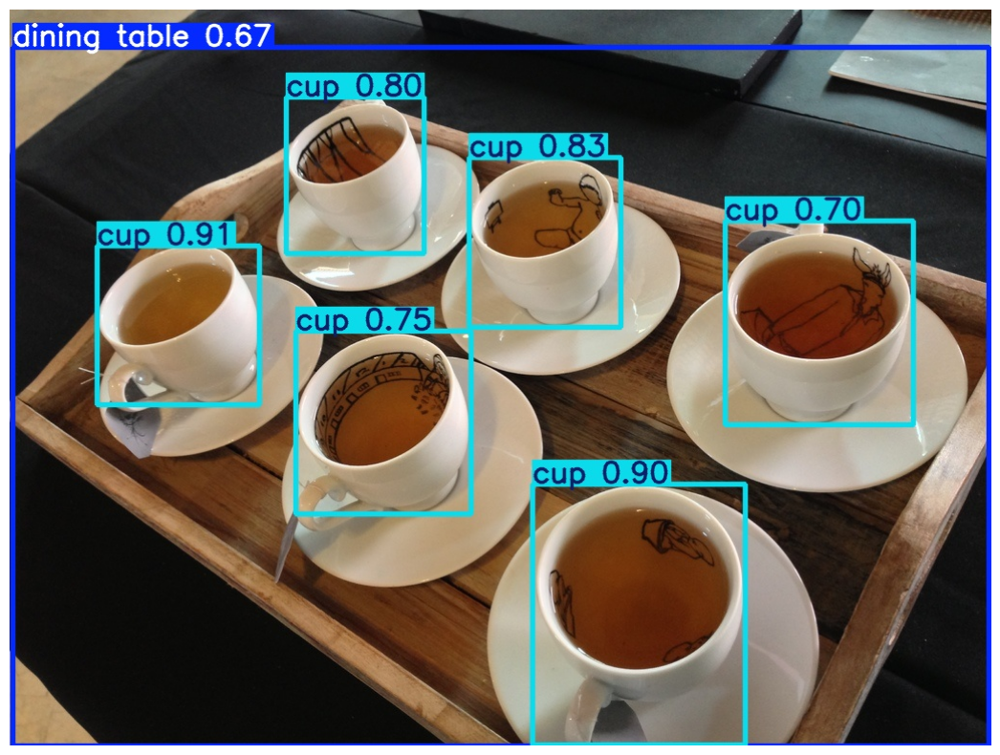

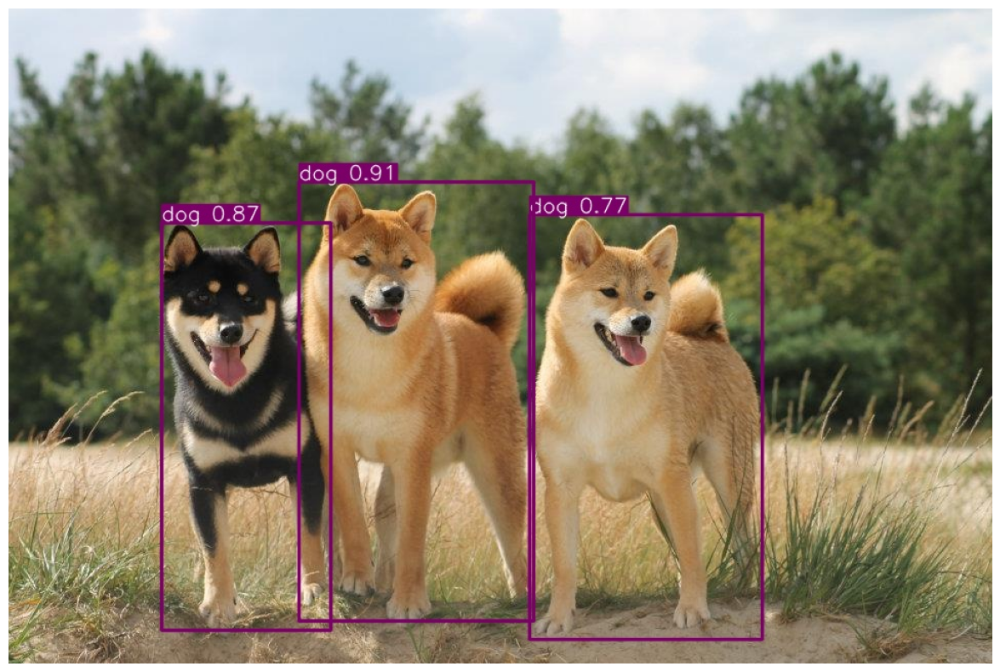

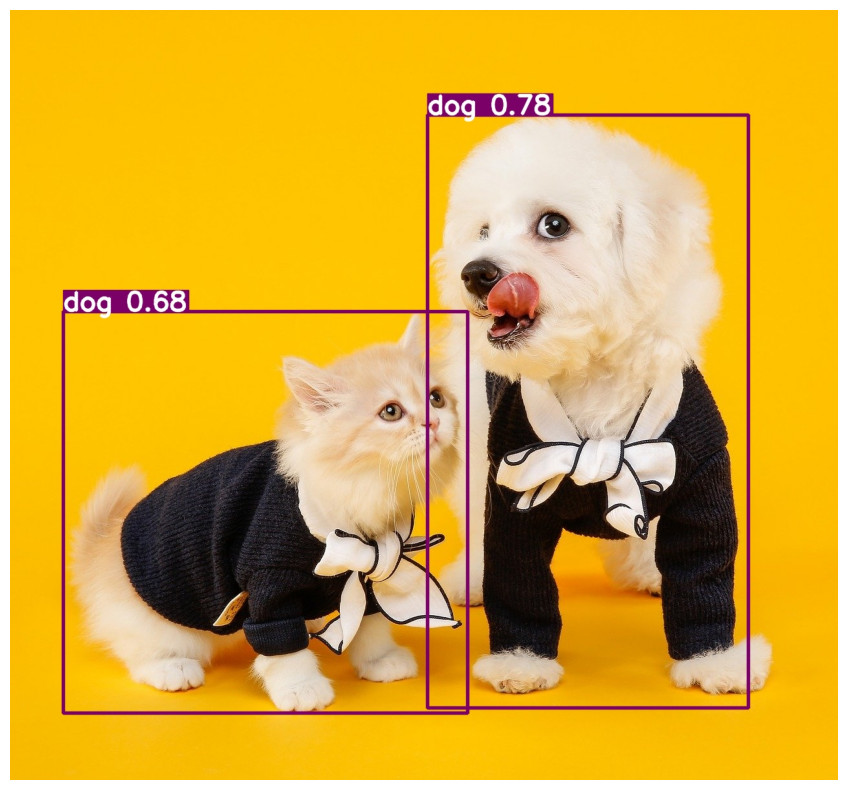

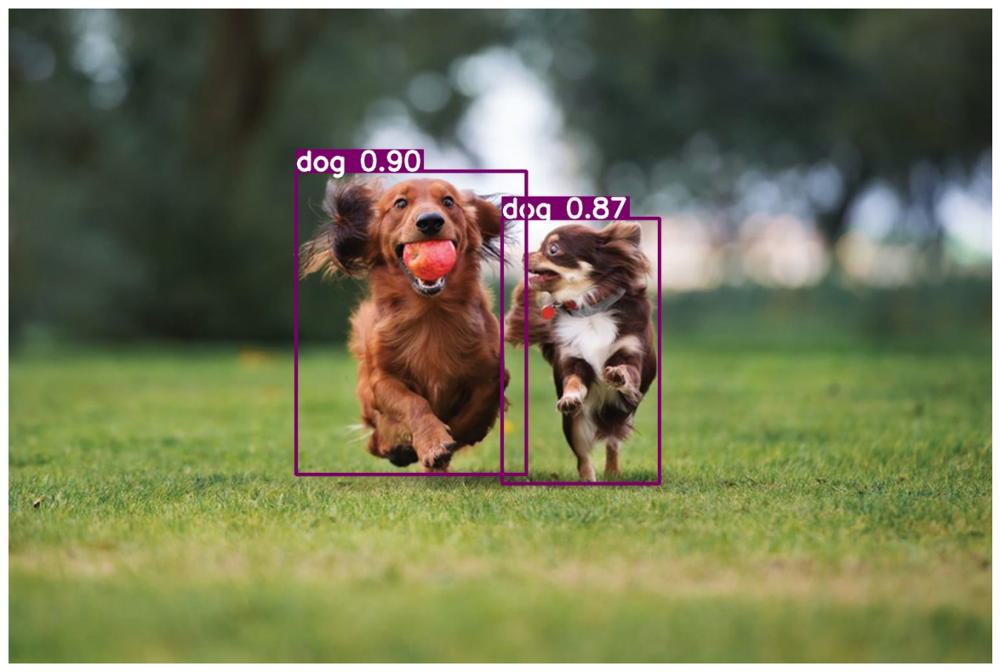

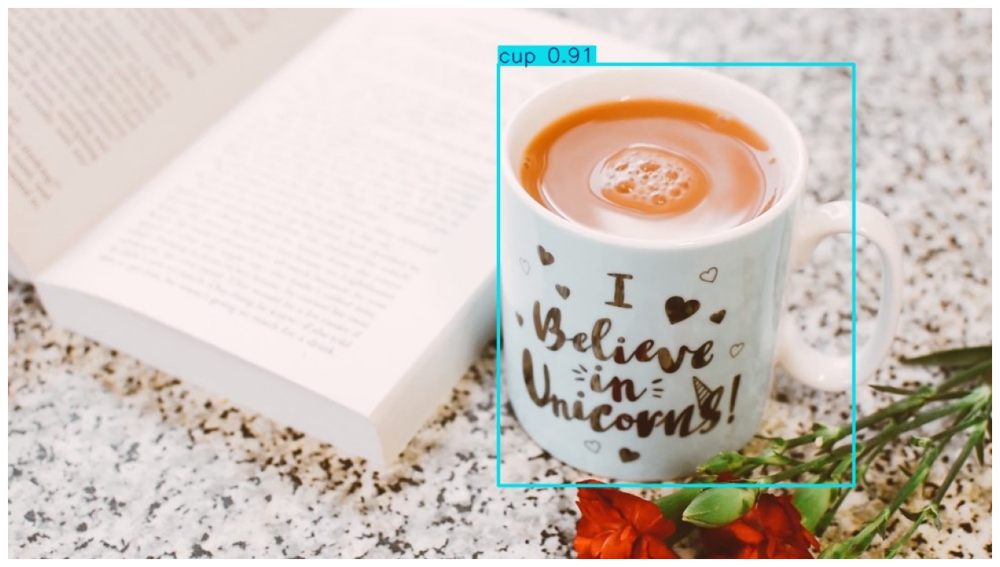

In [27]:
from pathlib import Path

dir_results = Path('/content/runs/detect/predict6')

# Itera o diretório dos resultados
# for path in dir_results.iterdir():
#   if not path.is_dir(): # Caso não for uma pasta
#     img = cv2.imread(path) # Exibe a imagem
#     view(img)

# Alternativa do prof com compreensão de listas, adquirindo todos os paths das imagens
paths = [os.path.join(dir_results, path) for path in os.listdir(dir_results)]

for img_path in paths:
  img = cv2.imread(img_path)
  view(img)

### Realizando a detecção via **Python**

Com o método através do Python, é mais fácil integrar com as nossas aplicações, pois é **retornado as bboxes (bounding boxes / caixas delimitadoras)**, onde podemos realizar recortes ou qualquer outro processamento desejado :)

#### YOLOv8n (Nano)

In [28]:
from ultralytics import YOLO

In [57]:
model = YOLO('yolov8n.pt')

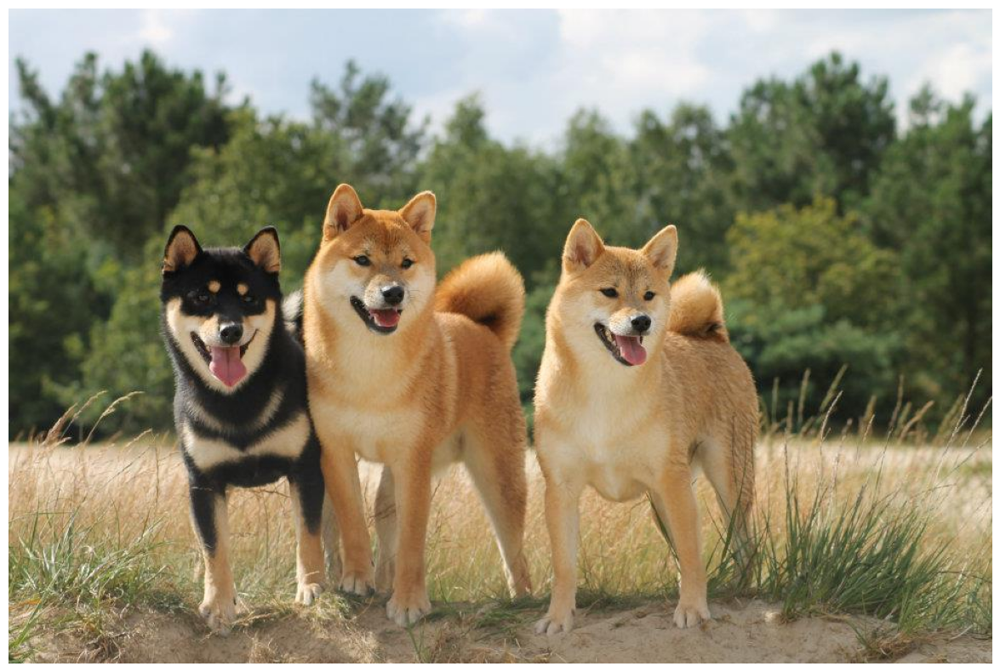

In [79]:
img = cv2.imread(IMAGES_DIR + '/cachorros.jpg')
view(img)

Para detecção usaremos o método model.predict().

Ele aceita basicamente os mesmos parâmetros do método via CLI, que vimos nos exemplos acima.

**source** -> A função aceita a imagem nos seguintes formatos: diretório, caminho, URL, vídeo, webcam (valor 0, que corresponde ao índice do dispositivo de câmera)

**save** -> Se deseja salvar a imagem no diretório predict (aqui iremos fazer de outra maneira, então não precisamos configurar esse parâmetro)

**conf** -> Limiar de confiança

**show** -> Informe o parâmetro show=True para mostrar os valores das predições

**save_txt** - Se deseja salvar em um txt os resultados.

In [80]:
results = model.predict(source=img)


0: 448x640 3 dogs, 10.6ms
Speed: 3.2ms preprocess, 10.6ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


In [81]:
results

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted p

In [82]:
results[0].boxes.data # Bounding boxes

tensor([[283.1532, 169.5638, 512.2337, 598.1313,   0.9148,  16.0000],
        [149.1955, 209.6508, 314.2424, 607.8420,   0.8710,  16.0000],
        [508.2427, 201.4484, 735.6124, 616.0320,   0.7675,  16.0000]], device='cuda:0')

In [83]:
for r in results:
  print(r.boxes.data) # Visualização dos bouding boxes caso houver mais de uma imagem

tensor([[283.1532, 169.5638, 512.2337, 598.1313,   0.9148,  16.0000],
        [149.1955, 209.6508, 314.2424, 607.8420,   0.8710,  16.0000],
        [508.2427, 201.4484, 735.6124, 616.0320,   0.7675,  16.0000]], device='cuda:0')


In [75]:
for r in results:
  print(r.boxes.conf) # Visualização da probabilidade de confiança

tensor([0.9128, 0.9026, 0.8281, 0.7972, 0.7492, 0.7021, 0.6742], device='cuda:0')


In [84]:
import funcoes_desenho # Função python para visualização das caixas delimitadoras feito pelo professor

In [85]:
result_boxes = funcoes_desenho.desenha_caixas(img, results[0].boxes.data)

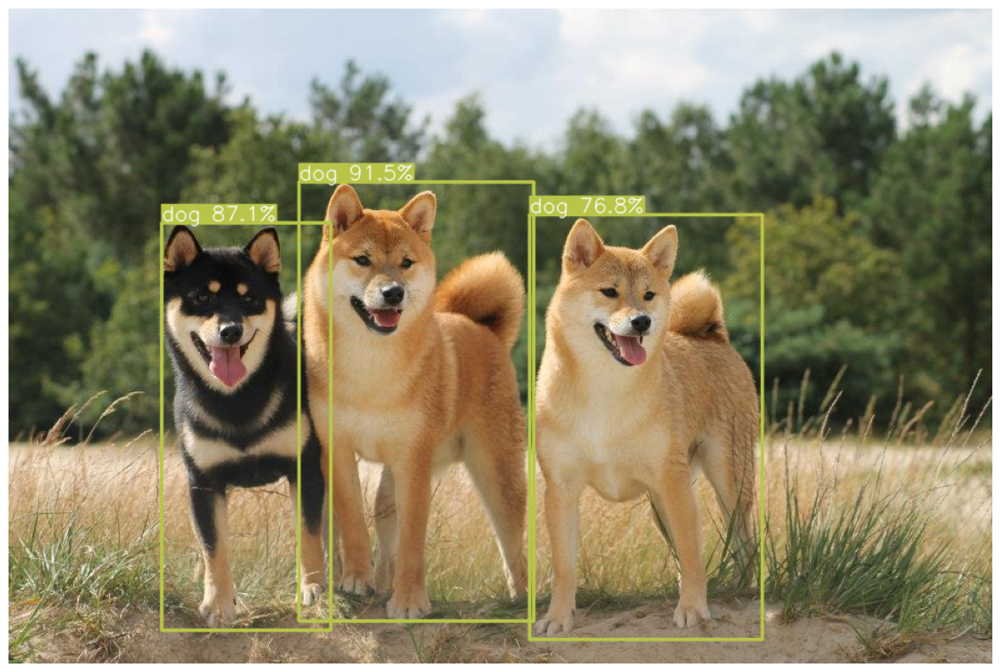

In [86]:
view(result_boxes)

#### Testando com outros modelos YOLOv8x (Extra large)

In [66]:
model_x = YOLO('yolov8x.pt')

100%|██████████| 131M/131M [00:00<00:00, 311MB/s]


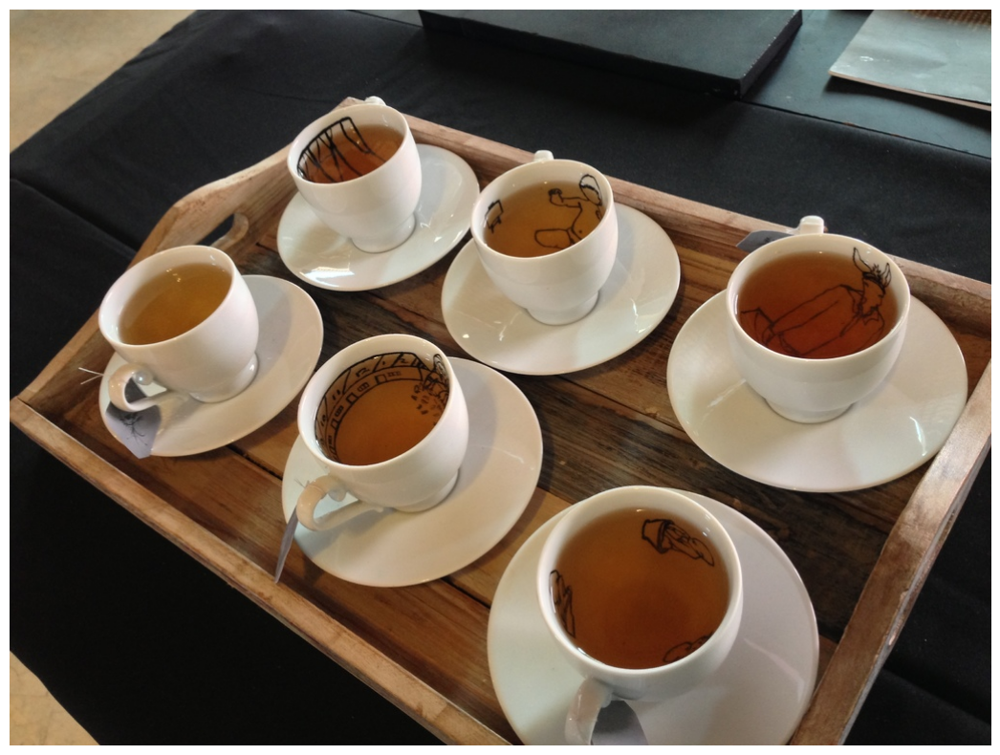

In [88]:
img = cv2.imread(IMAGES_DIR + '/img-canecas.jpg')
view(img)


0: 480x640 6 cups, 15.4ms
Speed: 2.9ms preprocess, 15.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


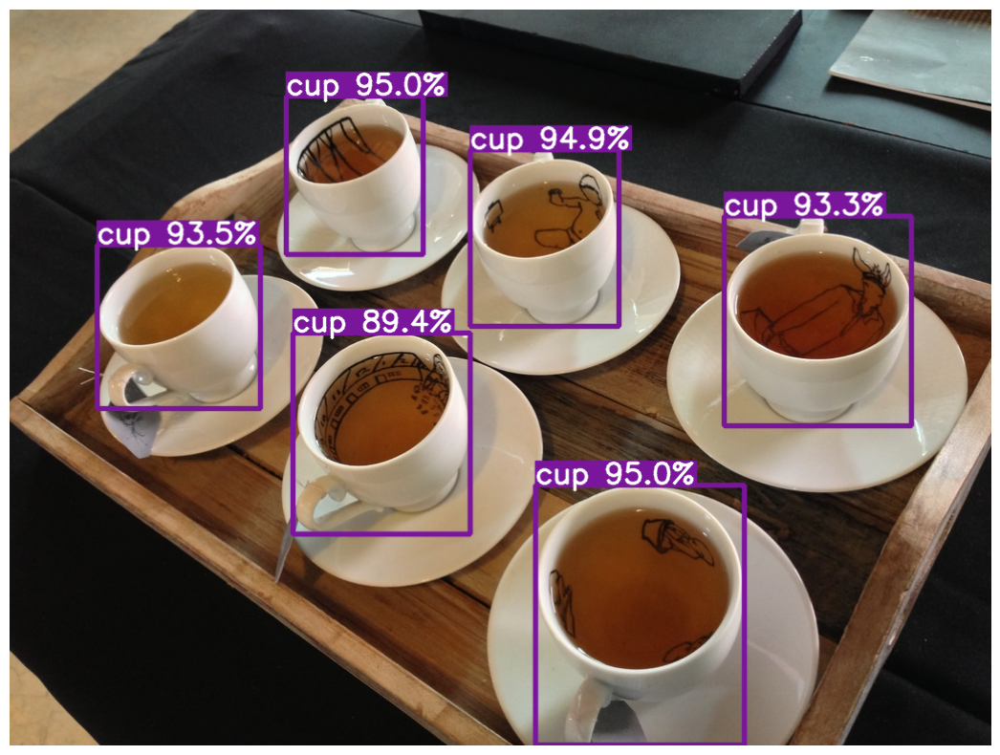

In [89]:
results_x = model_x.predict(source=img, conf=0.8)
results_x_boxes = funcoes_desenho.desenha_caixas(img, results_x[0].boxes.data)

view(results_x_boxes)

#### Validação do modelo

In [90]:
import torch

torch.hub.download_url_to_file('https://ultralytics.com/assets/coco2017val.zip', 'tmp.zip')

100%|██████████| 780M/780M [00:22<00:00, 36.8MB/s]


In [91]:
!unzip -q tmp.zip -d ../datasets && rm tmp.zip

In [93]:
!yolo task=detect mode=val model=yolov8x.pt data=coco128.yaml

Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8x summary (fused): 112 layers, 68,200,608 parameters, 0 gradients, 257.8 GFLOPs

Dataset 'coco128.yaml' images not found ⚠️, missing path '/content/datasets/coco128/images/train2017'
100% 6.66M/6.66M [00:00<00:00, 390MB/s]
Unzipping /content/datasets/coco128.zip to /content/datasets/coco128...: 100% 263/263 [00:00<00:00, 4118.57file/s]
Dataset download success ✅ (1.7s), saved to /content/datasets

100% 755k/755k [00:00<00:00, 109MB/s]
val: Scanning /content/datasets/coco128/labels/train2017... 126 images, 2 backgrounds, 0 corrupt: 100% 128/128 [00:00<00:00, 1454.26it/s]
val: New cache created: /content/datasets/coco128/labels/train2017.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 8/8 [00:04<00:00,  1.82it/s]
                   all        128        929      0.837      0.688      0.829      0.668
                person         61        254    

#### Detecção em vídeos (CLI)

In [95]:
VIDEOS_PATH = '/content/drive/MyDrive/videos'

In [108]:
!yolo task=detect mode=predict model=yolov8x.pt conf=0.5 source='/content/drive/MyDrive/videos/video_pessoas01.mp4' save=true

Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8x summary (fused): 112 layers, 68,200,608 parameters, 0 gradients, 257.8 GFLOPs

video 1/1 (frame 1/428) /content/drive/MyDrive/videos/video_pessoas01.mp4: 384x640 4 persons, 1 backpack, 1 laptop, 1 book, 65.5ms
video 1/1 (frame 2/428) /content/drive/MyDrive/videos/video_pessoas01.mp4: 384x640 5 persons, 1 backpack, 1 laptop, 1 book, 12.5ms
video 1/1 (frame 3/428) /content/drive/MyDrive/videos/video_pessoas01.mp4: 384x640 4 persons, 1 backpack, 1 laptop, 1 book, 12.3ms
video 1/1 (frame 4/428) /content/drive/MyDrive/videos/video_pessoas01.mp4: 384x640 4 persons, 1 backpack, 1 laptop, 1 book, 12.3ms
video 1/1 (frame 5/428) /content/drive/MyDrive/videos/video_pessoas01.mp4: 384x640 4 persons, 1 backpack, 1 laptop, 1 book, 12.3ms
video 1/1 (frame 6/428) /content/drive/MyDrive/videos/video_pessoas01.mp4: 384x640 5 persons, 1 backpack, 1 laptop, 1 book, 12.4ms
video 1/1 (frame 7/428) /content/drive/MyDri

Exibindo o resultado no vídeo:

In [115]:
video_saved = '/content/runs/detect/predict8/video_pessoas01.avi'
final_video = '/content/video_pessoas01_resultado.mp4'

os.system(f'ffmpeg -i {video_saved} -vcodec libx264 {final_video}')

0

In [118]:
from IPython.display import HTML
from base64 import b64encode

def show_video(video_path):
  mp4 = open(video_path, 'rb').read()
  data_url = 'data:video/mp4;base64,' + b64encode(mp4).decode()

  return HTML("""
  <video width=500 controls>
    <source src="%s" type="video/mp4">
  </video>
  """ % data_url)

In [119]:
show_video(final_video)

#### Segmentação de imagens

##### Via CLI

In [120]:
!yolo task=segment mode=predict model=yolov8m-seg.pt conf=0.5 source='/content/drive/MyDrive/imagens/cachorros.jpg' save=true

100% 52.4M/52.4M [00:01<00:00, 36.6MB/s]
Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8m-seg summary (fused): 105 layers, 27,268,704 parameters, 0 gradients, 110.2 GFLOPs

image 1/1 /content/drive/MyDrive/imagens/cachorros.jpg: 448x640 3 dogs, 79.1ms
Speed: 4.6ms preprocess, 79.1ms inference, 178.8ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/segment/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


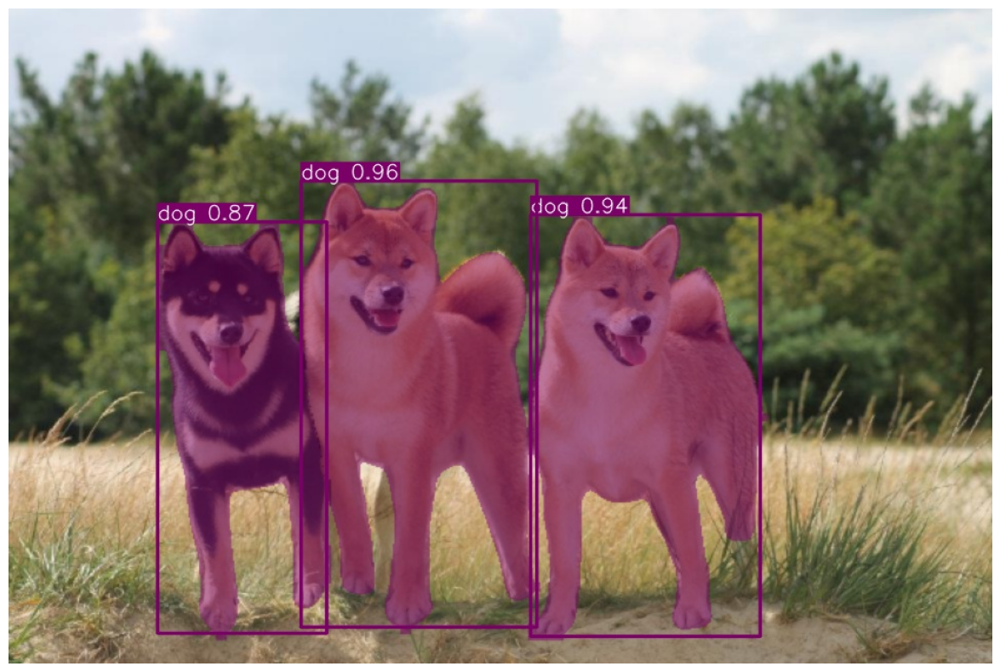

In [123]:
img_seg = cv2.imread('/content/runs/segment/predict/cachorros.jpg')
view(img_seg)

##### Via Python

In [142]:
model_seg = YOLO('yolov8m-seg.pt')
img = cv2.imread('/content/drive/MyDrive/imagens/cachorros.jpg')

In [143]:
results_seg = model_seg.predict(source=img, conf=0.6)
results_seg


0: 448x640 3 dogs, 12.3ms
Speed: 2.6ms preprocess, 12.3ms inference, 2.4ms postprocess per image at shape (1, 3, 448, 640)


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: ultralytics.engine.results.Masks object
 names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 

Abaixo a segmentação não ocorre pois as segmentações são retornadas agora em uma propriedade chamada "masks", portanto, necessitaria um outro algoritmo para renderizar as segmentações. Porém, não nos preocuparemos com isto agora.

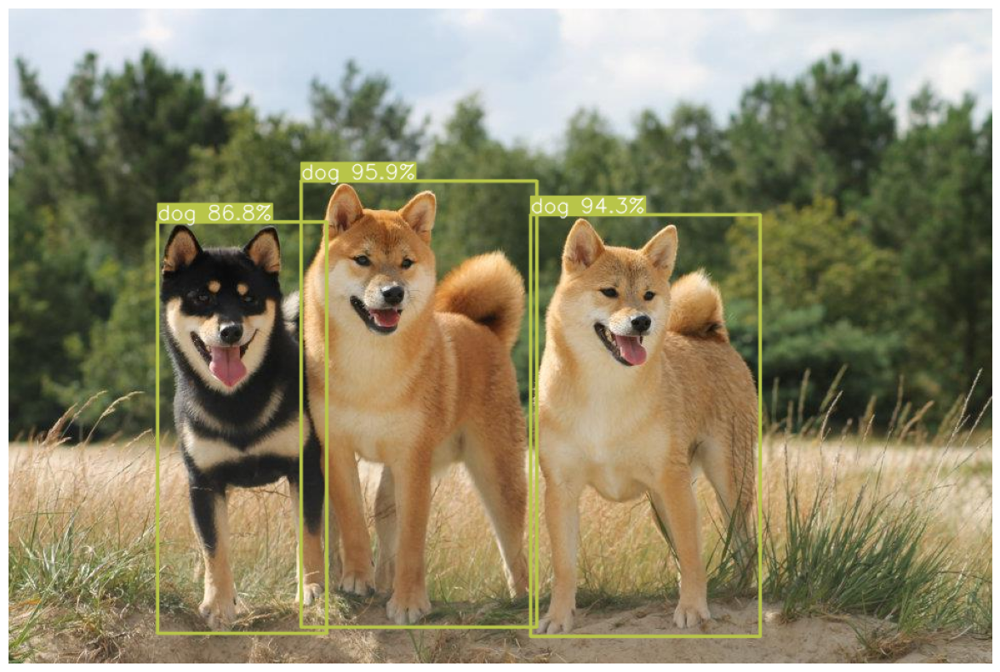

In [144]:
results_img_seg = funcoes_desenho.desenha_caixas(img, results_seg[0].boxes.data)
view(results_img_seg)

##### Segmentação em vídeo

In [145]:
!yolo task=segment mode=predict model=yolov8m-seg.pt conf=0.5 source='/content/drive/MyDrive/videos/video_rua01.mp4' save=true

Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8m-seg summary (fused): 105 layers, 27,268,704 parameters, 0 gradients, 110.2 GFLOPs

video 1/1 (frame 1/349) /content/drive/MyDrive/videos/video_rua01.mp4: 384x640 2 persons, 1 car, 104.2ms
video 1/1 (frame 2/349) /content/drive/MyDrive/videos/video_rua01.mp4: 384x640 2 persons, 2 cars, 11.2ms
video 1/1 (frame 3/349) /content/drive/MyDrive/videos/video_rua01.mp4: 384x640 3 persons, 1 car, 11.0ms
video 1/1 (frame 4/349) /content/drive/MyDrive/videos/video_rua01.mp4: 384x640 4 persons, 1 car, 11.4ms
video 1/1 (frame 5/349) /content/drive/MyDrive/videos/video_rua01.mp4: 384x640 5 persons, 1 car, 11.1ms
video 1/1 (frame 6/349) /content/drive/MyDrive/videos/video_rua01.mp4: 384x640 5 persons, 1 car, 11.1ms
video 1/1 (frame 7/349) /content/drive/MyDrive/videos/video_rua01.mp4: 384x640 6 persons, 1 car, 10.8ms
video 1/1 (frame 8/349) /content/drive/MyDrive/videos/video_rua01.mp4: 384x640 7 persons, 1 car,

In [146]:
video_saved = '/content/runs/segment/predict2/video_rua01.avi'
final_video = '/content/video_rua01_resultado.mp4'

os.system(f'ffmpeg -i {video_saved} -vcodec libx264 {final_video}')

0

In [147]:
show_video(final_video)